### The purpose of this code is to try to regain access to the animation plot

In [2]:
# load relevant packages

import sys


### Please append the SMA folder that contains DORA 
sys.path.append(r'D:/Jerry/code/OMMxDORA-tomerge/sma/') #if you are not amanda, change to your sma file path (found in zipfile downloaded from github)


import DORA
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import os
import itertools

In [20]:
#universal parameters

pixel_size = 117  # in nanometers
time_step = 100  # miliseconds per frame in trajectory movie
frame_start = 0  # enter 0 to start from beginning of dataset
frame_end = 100  # enter -1 to end at the last value of the data set
cmap = "spring_r" # enter a color map string from this https://matplotlib.org/2.0.2/examples/color/colormaps_reference.html
first_zero_end = 'no'  # yes to cut off all values after first 0,0 = x,y
graph_centers = "yes" #'yes' or 'no' to graphing the centers of the data. 
save_plot = 'yes' 

#downsampling parameters
bin_size = 20  # bin size for downsample/filter processing
processing = "none"  # enter downsample, moving average, or none

#Plot Parameters

#Which Graph?
# plot_type = "interactive"
plot_type = "2D"
# Graphing options:
    # Trajectory Maps:
    # 2D: Colorful 2D visulization of the rotor from above
    # 3D: 2D plot but time is an axis

    # Grid plot
    # grid: a grid of little snippets of the data

    # Angular Analysis:

    #         By Jerry
    # radius_filter: Demarcate the excluded data points that will be eliminated from calculations
    # find_excluded_angle: Indicate excluded angles within angular_continuous by Jerry
    # angular_continuous_filtered: Angular Continuous recalculated with excluded points filtered. Excluded points skips indicated.
    # basal3: Graphs tailored for the basal graph analysis 3/14/2022
    # Angular Continuous with a downsampled curve as well. still has bugs with excluded type labelling

    #         By Claire:  [NOT DONE]
    # angular: angle vs time, but it's not cummulative and resets at 360 to 0 (Claire)
    # angular_continuous: Claire's Calculation of a cummulative angle
    # find_excluded_angle_CR: Indicate excluded angles within angular_continuous by Claire's calculations

    # Animation   [NOT DONE]
    # interactive: Interactive graph
    # animated: animated trajectory in notebook
    # HTML: Animated trajectory in a new window. May run better

##### Trajectory Maps Parameters:

# "yes" enables center display of center coordinates if 2D or Find excluded angle
display_center = "no"

#Labels
x_axis_label = "x (nm)"
y_axis_label = "y (nm)"
z_axis_label = "Time (ms)"  
unit = "nm"  # enter pixel or nm

#Formatting parameters
pixel_min = -0.75  # setting min/max axis range (pixel)
pixel_max = 0.75

# change axis increments for nicely fitting tick marks (pixel)
axis_increment_pixel = 7
# change axis increments for nicely fitting tick marks (nm)
axis_increment_nm = 7
nm_min = -150  # setting min/max axis range (nm)
nm_max = 150
#Do you want to save your plot?
save_plot = 'yes'

#########Angle Versus Time (AVT or avt) Graphs

#       Formatting parameters for 'radius filter plot'
rad_filter_type_lower = 'nm'  # enter 'zscore' or 'nm' for choice
rad_filter_type_upper = 'zscore'  # enter 'zscore' or 'nm' for choice
z_up = 3  # enter an upper bound for z score.
z_down = -3  # enter a lower bound for z score
dist_low = 30  # lower bound for ABS of Radius filter
dist_high = 70  # upper bound for ABS of Radius filter

#       Formatting parameters for 'angular_continuous_filtered' plot
# enter 'line' or 'scatter' for a line graph or a scatter plot. Line plot makes up points when hovered
graph_style = 'line'


#Formatting parameters 'grid' plot
frames_per_plot = 20  # refers to grid plot
columns = 7  # columns of plots (grid plot)
fig_size_x = 40 # adjust display parameters for graphs to fit nicely, mostly used for 'grid' plot
fig_size_y  = 40 # adjust display parameters for graphs to fit nicely, mostly used for 'grid' plot

#Formatting parameters 'animation' plot
frame_speed = 20  # for animation only (ms)
tail_length = 50  # for animation only

#DORA.table parameters: 
save_table = 'no' #saves filtered table if "yes"

#DORA.collect_variable parameter package
###DataTable = avt_good cannot have bc it has not been defined yet
col = "Delta Angle"
name_saving_folder = "Data Tables"

In [21]:
# Input folder where file is saved. 
down_sampled_data_folder = r"D:\Jerry\code\OMMxDORA-tomerge\test_set\small_csv_batch\trimmed_csv"
# Input name of file
down_sampled_csv = "OrbitBiotin500Hz100Lz_1k_00001_trimmed.csv"
file_name = down_sampled_csv # override above file name above with this file name 

# Append saving file to saving folder path
down_sampled_data_file_path = os.path.join(down_sampled_data_folder,down_sampled_csv)
# read in file and redefine the new file as the new down_sampled_df
down_sampled_df = pd.read_csv(down_sampled_data_file_path)


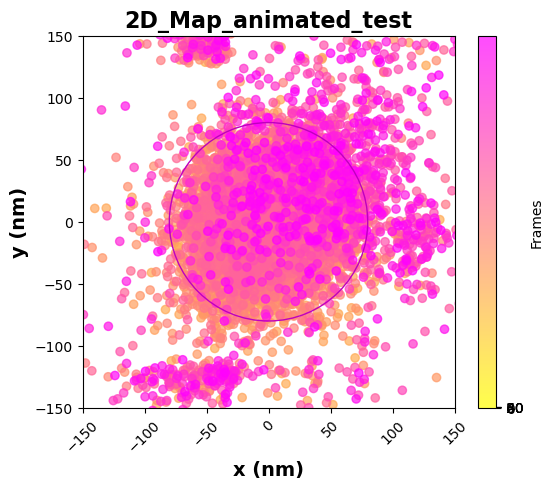

In [25]:
# run DORA.graph --> Grid graph
exp_tag="animated_test"
#intialize parameters for grid graph
#Trajectory map parameters:
tajectory_map_parameters = [file_name, down_sampled_df, plot_type, display_center, exp_tag, x_axis_label, y_axis_label, z_axis_label, unit, 
pixel_min, pixel_max, axis_increment_nm, axis_increment_pixel, nm_min, nm_max, save_plot, frame_start, frame_end, time_step,cmap,exp_tag]

if plot_type == "2D" or plot_type == "3D":
    DORA.graph(plot_type,*tajectory_map_parameters)
    

Animated Plot Graphing

In [26]:
import plotly.express as px

In [32]:
df = down_sampled_df
df_short = df.iloc[0:100,:]
df_short

,Unnamed: 0,index,X position,Y position,Intensity,X displacement (pixels),Y displacement (pixels),X displacement (nm),Y displacement (nm),Time (ms),Radius (nm),z-score Rad,Angle
0,0,0,5.954580,71.577850,1112.0,0.276716,0.132236,32.375823,15.471597,0,35.882645,-0.100644,334.458030
1,1,1,5.957685,71.602509,1473.0,0.279821,0.156894,32.739015,18.356607,2,37.534093,-0.069810,330.720863
2,2,2,5.856493,71.599800,1463.0,0.178629,0.154186,20.899551,18.039720,4,27.608382,-0.255134,319.200454
3,3,3,5.682285,71.716194,1288.0,0.004421,0.270580,0.517252,31.657823,6,31.662048,-0.179448,270.936063
4,4,4,5.770096,71.555923,1343.0,0.092232,0.110309,10.791138,12.906152,8,16.823122,-0.456508,309.899792
...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,95,95,5.859251,71.649933,1411.0,0.181387,0.204318,21.222296,23.905252,190,31.966340,-0.173766,311.597615
96,96,96,5.816833,71.465210,1559.0,0.138969,0.019595,16.259334,2.292672,192,16.420179,-0.464031,351.973836
97,97,97,5.680199,71.797569,1248.0,0.002335,0.351955,0.273171,41.178712,194,41.179618,-0.001744,270.380083
98,98,98,5.675840,71.491165,1264.0,-0.002024,0.045551,-0.236805,5.329431,196,5.334689,-0.671010,267.455825


In [27]:
df = down_sampled_df
px.scatter(df,x= "X displacement (nm)", y = "Y displacement (nm)", animation_frame = "Time (ms)", )

In [28]:
    if plot_type in animations:
        
        # Accept my variables from graphing parameters
        (file_name, down_sampled_df, plot_type, display_center, ind_invalid_reading, rad_filter_type_upper,
                  rad_filter_type_lower, z_up, z_down, dist_high, dist_low, graph_style, bin_size, frame_start, frame_end,
                  display_center, exp_tag, x_axis_label, y_axis_label, z_axis_label, unit, pixel_min, pixel_max,
                  axis_increment_nm, axis_increment_pixel, nm_min, nm_max, save_plot, data_back, cmap, exp_tag, frame_speed, tail_length) = graph_parameters


        # Claire's code accepts down_sampled_df as df
        df = down_sampled_df

        #####################Graphing data assignment block##############
        # Here the code determines the units of the graph, only for cartesian graphs
        if unit == "pixel":
            x = df["X displacement (pixels)"]
            y = df["Y displacement (pixels)"]
        if unit == "nm":
            x = df["X displacement (nm)"]
            y = df["Y displacement (nm)"]
        z = df["Time (ms)"]

        if plot_type == "animated" or plot_type == 'HTML':
#             # allows for animation to animate
#             %matplotlib notebook
            #reassigning to a dataframe, setting up axis with empty list, aspect ratio
            coord = pd.DataFrame(x)
            coord.columns = ['x']
            coord['y'] = y
            fig = plt.figure()
            ax = fig.add_subplot(111)
            sc = ax.scatter([], [])
            plt.axis('square')
            
            
            #Title configuration

            # take the file name and separate from the extension
            # the first value in the tuple is the number
            # the second is .csv 
            # the number 00086.csv is the peak --> so this code takes the peak number
            pk = os.path.splitext(file_name)[0]

            graph_type = 'Animated_2D_Plot'

            # change title order!!! 
            list_of_strings = [graph_type, exp_tag, pk]

            #in quotes is the the delimiter between the items in the string
            # by default it is a _ 
            my_title = "_".join(list_of_strings)
           

            # plot title and font configurations
            plt.title(my_title , fontweight = 'bold', fontsize = 16)
            
            # chosing units
            if unit == "pixel":
                    ax.set_xlim(pixel_min, pixel_max) 
                    ax.set_ylim(pixel_min, pixel_max)
                    ax.yaxis.set_major_locator(ticker.LinearLocator(axis_increment_pixel))# change to 5 for increments of .5
                    ax.xaxis.set_major_locator(ticker.LinearLocator(axis_increment_pixel))
                    ax.grid()
            if unit == "nm":
                    ax.set_xlim(nm_min, nm_max) 
                    ax.set_ylim(nm_min, nm_max)
                    ax.yaxis.set_major_locator(ticker.LinearLocator(axis_increment_nm))
                    ax.xaxis.set_major_locator(ticker.LinearLocator(axis_increment_nm))
                    ax.grid()
            ax.set_xlabel(x_axis_label, fontweight = 'bold', fontsize = 12)
            ax.set_ylabel(y_axis_label, fontweight = 'bold', fontsize = 12)

            # plot title and font configurations
            plt.title(my_title , fontweight = 'bold', fontsize = 16)





            # animation function feeds a window of dataframe values into the graphing function at a time,
            # iterates over user specified range in dataframe with user specified tail length
            # color of animation is also specified here
            def animate(count):
                sc.set_offsets(np.c_[coord.x.values[count-tail_length:count],coord.y.values[count-tail_length:count]])
                cmap = plt.cm.Greens
                norm = plt.Normalize(vmin=0, vmax=tail_length)
                z = np.array(range(tail_length))
                c = cmap(norm(z))
                sc.set_color(c)
                #button_ax = plt.axes([.78, .87, .1, .07]) # creates an outline for a potential button
               
                return sc

            ani = FuncAnimation(fig, animate, interval= frame_speed, frames = len(coord)) #frames=len(df)
            #ani.toggle(ax=button_ax)# potential button toggle for a potential button ;)
            if save_plot == 'yes':
                
                ani.save(my_title+'_animation_gif.gif', writer='pillow', fps=10, dpi=100)





            plt.tight_layout()
            plt.show()
            # With out the added if statement below, the animated plot will not animate 
            #(due to being a nested function)
        if plot_type == 'animated': 

                

            return ani
        # 
        if plot_type == 'HTML':
            plt.close('all')
            if save_plot == 'yes':
                with open(my_title+"_animation_html.html", "w") as f:
                    print(ani.to_jshtml(), file=f)

                    HTML(ani.to_jshtml())



SyntaxError: 'return' outside function (1036777346.py, line 112)